In [1]:
import os
#0, 1, 2, 3있음
#os.environ["CUDA_VISIBLE_DEVICES"] = "0,1,2,3"
os.environ["CUDA_VISIBLE_DEVICES"] = "2"
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns

import random
import cv2
from sklearn.model_selection import train_test_split
#from sklearn.preprocessing import LabelEncoder
#from tensorflow.keras.preprocessing.image import ImageDataGenerator

import seaborn as sns
#from tensorflow.keras.models import load_model
import copy

import seaborn as sns
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping
#from tensorflow.keras import optimizers
#from tensorflow.keras import activations
#from tensorflow.keras.models import Sequential

from tensorflow.keras.initializers import he_normal

from keras import backend as K
#from PIL import Image
#from tensorflow.keras import optimizers
#from tensorflow.keras import activations
#from tensorflow.keras.models import Sequential
#from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Activation
#from tensorflow.keras.models import Model

from keras.layers import Input, Dropout, Activation, Add, BatchNormalization, Conv2D, Concatenate, UpSampling2D
np.random.seed(42)
tf.random.set_seed(42)

# [Data]
#### : https://www.kaggle.com/datasets/faizalkarim/flood-area-segmentation?select=Mask

In [2]:
# 이미지&마스크 불러오기
def data_loader(path, image_size=(512,512)):
    # 숫자로 된 파일명을 기준으로 이미지 파일 목록을 얻기
    image_files = [f for f in os.listdir(path) if f.split('.')[0].isdigit() and f.endswith('.jpg')]
    image_files.sort(key=lambda x: int(x.split('.')[0]))  # 파일명을 숫자로 변환하여 정렬
    
    image_list = []

    for image_file in image_files:
        image_path = os.path.join(path, image_file)
        image = cv2.imread(image_path, cv2.IMREAD_COLOR)
        
        # 이미지 파일이 실제로 존재하는지 확인
        if image is not None:
            image = cv2.resize(image, image_size)
            image = image.reshape(512, 512, 3)
            image_list.append(image / 255.0)
        else:
            # 이미지 파일이 존재하지 않으면 로깅 (옵션)
            print(f"Failed to load image: {image_path}")
    return image_list

def mask_loader(path, image_size=(512,512)):
    # 숫자로 된 파일명을 기준으로 이미지 파일 목록을 얻기
    image_files = [f for f in os.listdir(path) if f.split('.')[0].isdigit() and f.endswith('.png')]
    image_files.sort(key=lambda x: int(x.split('.')[0]))  # 파일명을 숫자로 변환하여 정렬
    
    image_list = []

    for image_file in image_files:
        image_path = os.path.join(path, image_file)
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        
        # 이미지 파일이 실제로 존재하는지 확인
        if image is not None:
            image = cv2.resize(image, image_size)
            image = image.reshape(512, 512, 1)
            image_list.append(image/255.0)
        else:
            # 이미지 파일이 존재하지 않으면 로깅 (옵션)
            print(f"Failed to load image: {image_path}")

    return image_list

In [3]:
# 이미지&마스크 시각화
#import matplotlib.pyplot as plt

def display_image_and_mask(image_list, mask_list, n):
    # n번째 이미지와 마스크를 추출
    image_ex = image_list[n] * 255
    mask_ex = mask_list[n]

    # 서브플롯 생성
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # 첫 번째 이미지 표시 (흑백이므로 색상 변환 없이 직접 표시)
    axes[0].imshow(image_ex.astype(np.uint8), cmap='gray')  # cmap='gray'로 흑백 이미지 표시
    axes[0].axis('off')
    axes[0].set_title('Image ' + str(n))

    # 두 번째 이미지(마스크) 표시 (흑백이므로 색상 변환 없이 직접 표시)
    axes[1].imshow(mask_ex.astype(np.uint8), cmap='gray')  # cmap='gray'로 흑백 이미지 표시
    axes[1].axis('off')
    axes[1].set_title('Mask ' + str(n))

    # 서브플롯 표시
    plt.show()

In [4]:
#픽셀값 min,max계산하려고 만든...
def cal_mm(image_list):
    max_img =[]
    min_img = []
    for i in range(0, np.shape(image_list)[0]):
        image = image_list[0]
        max = np.max(image)
        min = np.min(image)
        max_img.append(max)
        min_img.append(min)
    max_all = np.max(max_img)
    min_all = np.min(min_img)
    print('Max value: ', max_all)
    print('Min value: ', min_all)

In [5]:
# train/test split
def data_encoder(image, mask):
    X = copy.deepcopy(image)
    Y = copy.deepcopy(mask)

    X = np.array(X).astype(np.float32)
    Y = np.array(Y).astype(np.float32)

    # 데이터를 훈련 세트(80%)와 테스트 세트(20%)로 나누기
    X_train, X_temp, y_train, y_temp = train_test_split(X, Y
                                                                  , test_size=0.2224, random_state=42)
    # 나머지 데이터를 검증 세트(25%)와 테스트 세트(75%)로 나누기
    X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp
                                                                            , test_size=0.4995, random_state=42)
    return X_train, X_valid, X_test, y_train, y_valid, y_test

In [6]:
#깃허브.. 'model.py'에 있던...
def dice_coefficient(y_true, y_pred):
    """
    A statistic used for comparing the similarity of two samples. Here binary segmentations.

    Args:
        y_true (numpy.array): the true segmentation
        y_pred (numpy.array): the predicted segmentation

    Returns:
        (float) returns a number from 0. to 1. measuring the similarity y_true and y_pred
    """
    y_true_f=K.flatten(y_true)
    mu     = y_pred[:,:,:,0]
    y_pred_f=K.flatten(mu)
    intersection=K.sum(y_true_f*y_pred_f)
    smooth=1e-5
    return (2*intersection+smooth)/(K.sum(y_true_f)+K.sum(y_pred_f)+smooth)

def dice_loss(y_true, y_pred):
    return 1-dice_coefficient(y_true, y_pred)

def recall_smooth(y_true, y_pred):
    y_pred_f = K.flatten(y_pred)
    y_true_f = K.flatten(y_true)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection / (K.sum(y_true_f) + K.epsilon()))  

def precision_smooth(y_true, y_pred):
    y_pred_f = K.flatten(y_pred)
    y_true_f = K.flatten(y_true)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection / (K.sum(y_pred_f) + K.epsilon()))

In [7]:
# aug..snippet? (깃허브 中 utils.py)
def random_snippet(x, y, size=(48,48), rotate=True, flip=True):
    '''sample snippets from images. return image tuple (real, segmentation) of size `size` '''
    
    assert x.shape[:2] == y.shape[:2]
    
    # get image sample
    sample = np.random.randint(0, x.shape[0])
    # get x and y dimensions
    min_h = np.random.randint(0, x.shape[1]-size[0])
    max_h = min_h+size[0]
    min_w = np.random.randint(0, x.shape[2]-size[1])
    max_w = min_w+size[1]
    # extract snippet
    im_x = x[sample, min_h:max_h, min_w:max_w, :]
    im_y = y[sample, min_h:max_h, min_w:max_w, :]
    
    # rotate
    if rotate:
        k = np.random.randint(0,3)
        im_x = np.rot90(im_x, k=k, axes=(0,1))
        im_y = np.rot90(im_y, k=k, axes=(0,1))
        
    # flip left-right, up-down
    if flip:
        if np.random.random() < 0.5:
            lr_ud = np.random.randint(0,2) # flip up-down or left-right?
            im_x = np.flip(im_x, axis=lr_ud)
            im_y = np.flip(im_y, axis=lr_ud)
    
    return (im_x, im_y)

def get_random_snippets(x, y, number, size):
    snippets = [random_snippet(x, y, size) for i in range(number) ]
     
    ims_x = np.array([i[0] for i in snippets])
    ims_y = np.array([i[1] for i in snippets])
    return (ims_x, ims_y)    

In [8]:
#aug후 5개씩 시각화
def display_instances(A,B):
    plt.rcParams['figure.figsize'] = [15, 5]
    M=6
    list_index = np.random.randint(low=0, high=A.shape[0], size=M)
    plt.figure(figsize=(20,20))
    fig, ax = plt.subplots(2,M)
    for k, ind in enumerate(list_index):
        ax[0,k].imshow(A[ind])
        ax[1,k].imshow(B[ind,:,:,0], cmap='gray')
        ax[0,k].axis('off')
        ax[1,k].axis('off')


In [9]:
# 층 정의
def Conv2DReluBatchNorm(n_filters, kernel_size, strides, inputs):
    x = Conv2D(n_filters, kernel_size, strides=strides, padding='same', kernel_initializer='he_normal')(inputs)
    #x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = Dropout(rate=0.1)(x)  # training + test-time dropout!
    return x


In [10]:
def UNet():
        # Input image
    input = tf.keras.layers.Input((256, 256, 3))

    # reduce image config
    s = tf.keras.layers.Lambda(lambda x: x / 256)(input)

    # block 1
    c1 = tf.keras.layers.Conv2D(16, (3, 3), activation="relu", kernel_initializer='he_normal', padding='same')(s)
    c1 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    c1 = tf.keras.layers.Dropout(0.1)(c1)
    c1 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    p1 = tf.keras.layers.MaxPooling2D((2, 2))(c1)

    # block 2
    c2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    c2 = tf.keras.layers.Dropout(0.1)(c2)
    c2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    p2 = tf.keras.layers.MaxPooling2D((2, 2))(c2)

    # block 3
    c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    c3  = tf.keras.layers.Dropout(0.2)(c3)
    c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    p3 = tf.keras.layers.MaxPooling2D((2, 2))(c3)

    # block 4
    c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
    c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
    c4 = tf.keras.layers.Dropout(0.2)(c4)
    c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
    p4 = tf.keras.layers.MaxPooling2D((2, 2))(c4)

    # block 5
    c5 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
    c5 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)
    c5 = tf.keras.layers.Dropout(0.3)(c5)
    c5 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)
    p5 = tf.keras.layers.MaxPooling2D((2, 2))(c5)

    # block 6
    c6 = tf.keras.layers.Conv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p5)
    c6 = tf.keras.layers.Conv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)
    c6 = tf.keras.layers.Dropout(0.3)(c6)
    c6 = tf.keras.layers.Conv2D(512, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)

    # block 7 - back 1
    u7 = tf.keras.layers.Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = tf.keras.layers.concatenate([u7, c5])
    c7 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
    c7 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)
    c7 = tf.keras.layers.Dropout(0.3)(c7)
    c7 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)

    # block 8 - back 2
    u8 = tf.keras.layers.Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = tf.keras.layers.concatenate([u8, c4])
    c8 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
    c8 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)
    c8 = tf.keras.layers.Dropout(0.2)(c8)
    c8 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)

    # block 9 - back 3
    u9 = tf.keras.layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = tf.keras.layers.concatenate([u9, c3])
    c9 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
    c9 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)
    c9 = tf.keras.layers.Dropout(0.2)(c9)
    c9 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)

    # block 10 - back 4
    u10 = tf.keras.layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c9)
    u10 = tf.keras.layers.concatenate([u10, c2])
    c10 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u10)
    c10 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c10)
    c10 = tf.keras.layers.Dropout(0.1)(c10)
    c10 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c10)

    # block 11 - back 5
    u11 = tf.keras.layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c10)
    u11 = tf.keras.layers.concatenate([u11, c1])
    c11 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u11)
    c11 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c11)
    c11 = tf.keras.layers.Dropout(0.1)(c11)
    c11 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c11)

    outputs = tf.keras.layers.Conv2D(1, (1, 1), activation='sigmoid')(c11)

    modelUNet = tf.keras.Model(inputs=input, outputs=outputs, name='U-NET')

    modelUNet.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy', dice_coefficient, precision_smooth, recall_smooth])

    return modelUNet

In [11]:
def train_model(A_train, B_train, A_valid, B_valid, epochs, batch_size):
    model = UNet()
    
    """
    모델을 학습시키는 함수입니다.
    
    :param model: 학습할 모델 객체
    :param A_train: 학습 데이터
    :param B_train: 학습 레이블
    :param A_valid: 검증 데이터
    :param B_valid: 검증 레이블
    :param epochs: 학습 에폭 수
    :param batch_size: 배치 크기
    :param log_dir: TensorBoard 로그 디렉터리 경로
    :return: 학습 결과
    """
    callbacks = [
        # EarlyStopping은 필요에 따라 주석 해제
        # tf.keras.callbacks.EarlyStopping(patience=2, monitor="val_loss"),
        tf.keras.callbacks.TensorBoard(log_dir="logs")
    ]

    results = model.fit(A_train, B_train,
                        validation_data=(A_valid, B_valid),
                        batch_size=batch_size,
                        epochs=epochs,
                        callbacks=callbacks)
    
    return results, model

In [12]:
def plot_training(hist):
    '''
    This function take training model and plot history of accuracy and losses with the best epoch in both of them.
    '''

    # Define needed variables
    tr_acc = hist.history['accuracy']
    tr_loss = hist.history['loss']
    val_acc = hist.history['val_accuracy']
    val_loss = hist.history['val_loss']
    index_loss = np.argmin(val_loss)
    val_lowest = val_loss[index_loss]
    index_acc = np.argmax(val_acc)
    acc_highest = val_acc[index_acc]
    Epochs = [i+1 for i in range(len(tr_acc))]
    loss_label = f'best epoch= {str(index_loss + 1)}'
    acc_label = f'best epoch= {str(index_acc + 1)}'

    # Plot training history
    plt.figure(figsize= (20, 8))
    plt.style.use('fivethirtyeight')

    plt.subplot(1, 2, 1)
    plt.plot(Epochs, tr_loss, 'r', label= 'Training loss')
    plt.plot(Epochs, val_loss, 'g', label= 'Validation loss')
    plt.scatter(index_loss + 1, val_lowest, s= 150, c= 'blue', label= loss_label)
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(Epochs, tr_acc, 'r', label= 'Training Accuracy')
    plt.plot(Epochs, val_acc, 'g', label= 'Validation Accuracy')
    plt.scatter(index_acc + 1 , acc_highest, s= 150, c= 'blue', label= acc_label)
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout
    plt.show()

In [13]:
#이미지&마스크 불러와

path_image = './Image'
image = data_loader(path_image)
print('Image :', np.shape(image))

path_mask = './Mask'
mask = mask_loader(path_mask)
print('mask :', np.shape(mask))

Image : (289, 512, 512, 3)
mask : (289, 512, 512, 1)


In [14]:
#픽셀 최대최소
cal_mm(image)

Max value:  1.0
Min value:  0.0


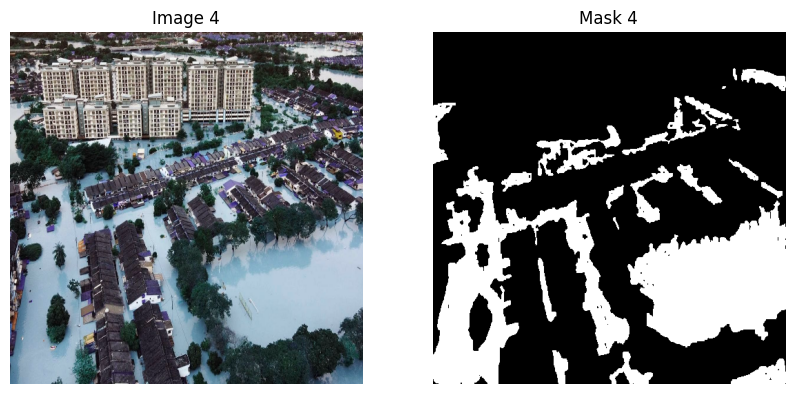

In [15]:
# aug전 k+1번째 이미지&마스크
k=4
display_image_and_mask(image, mask, k)

In [16]:
# 데이터셋 split
X_train, X_valid, X_test, y_train, y_valid, y_test = data_encoder(image, mask)

print('<Train> - X :', np.shape(X_train), ', Y : ', np.shape(y_train))
print('<Valid> - X :', np.shape(X_valid), ', Y : ', np.shape(y_valid))
print('<Test> - X :', np.shape(X_test), ', Y : ', np.shape(y_test))

<Train> - X : (224, 512, 512, 3) , Y :  (224, 512, 512, 1)
<Valid> - X : (32, 512, 512, 3) , Y :  (32, 512, 512, 1)
<Test> - X : (33, 512, 512, 3) , Y :  (33, 512, 512, 1)


In [17]:
N_train = 5000
N_valid = 2000
N_test = 3000

A_train, B_train = get_random_snippets(X_train, y_train, number=N_train, size=(256,256))
A_valid, B_valid = get_random_snippets(X_valid, y_valid, number=N_valid, size=(256,256))
A_test, B_test = get_random_snippets(X_test, y_test, number=N_test, size=(256,256))

print('X_train shape: ', A_train.shape)
print('Y_train shape: ', B_train.shape)
print('----------------------------------')
print('X_valid shape: ', A_valid.shape)
print('Y_valid shape: ', B_valid.shape)
print('----------------------------------')
print('X_test shape: ', A_test.shape)
print('Y_test shape: ', B_test.shape)

X_train shape:  (5000, 256, 256, 3)
Y_train shape:  (5000, 256, 256, 1)
----------------------------------
X_valid shape:  (2000, 256, 256, 3)
Y_valid shape:  (2000, 256, 256, 1)
----------------------------------
X_test shape:  (3000, 256, 256, 3)
Y_test shape:  (3000, 256, 256, 1)


<Figure size 2000x2000 with 0 Axes>

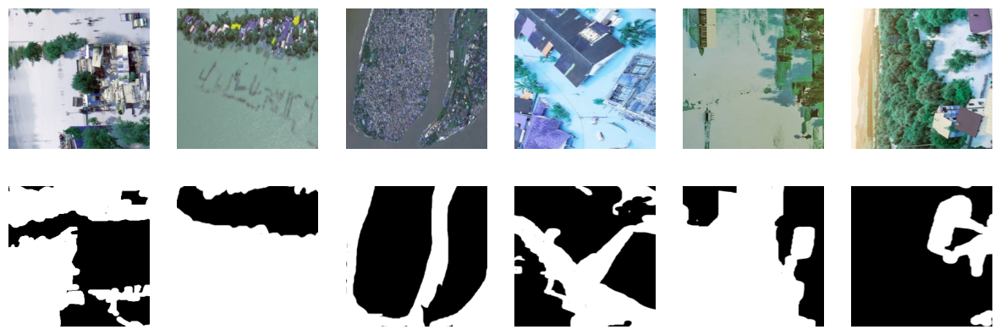

In [18]:
display_instances(A_train, B_train)

In [20]:
#m1:학습된  모델
result, m1 = train_model(A_train, B_train, A_valid, B_valid, 20, 8)

2024-01-08 20:48:15.825044: I tensorflow/core/profiler/lib/profiler_session.cc:131] Profiler session initializing.
2024-01-08 20:48:15.825076: I tensorflow/core/profiler/lib/profiler_session.cc:146] Profiler session started.
2024-01-08 20:48:16.575858: I tensorflow/core/profiler/lib/profiler_session.cc:164] Profiler session tear down.
2024-01-08 20:48:16.578235: I tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1748] CUPTI activity buffer flushed


Epoch 1/20
  1/625 [..............................] - ETA: 13:04 - loss: 0.6931 - accuracy: 0.5350 - dice_coefficient: 0.4143 - precision_smooth: 0.3537 - recall_smooth: 0.4998

2024-01-08 20:48:23.075937: I tensorflow/core/profiler/lib/profiler_session.cc:131] Profiler session initializing.
2024-01-08 20:48:23.075964: I tensorflow/core/profiler/lib/profiler_session.cc:146] Profiler session started.


  3/625 [..............................] - ETA: 3:32 - loss: 0.6930 - accuracy: 0.5183 - dice_coefficient: 0.4555 - precision_smooth: 0.4266 - recall_smooth: 0.4968

2024-01-08 20:48:23.583140: I tensorflow/core/profiler/lib/profiler_session.cc:66] Profiler session collecting data.
2024-01-08 20:48:23.585951: I tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1748] CUPTI activity buffer flushed
2024-01-08 20:48:23.616034: I tensorflow/core/profiler/internal/gpu/cupti_collector.cc:673]  GpuTracer has collected 846 callback api events and 840 activity events. 
2024-01-08 20:48:23.628734: I tensorflow/core/profiler/lib/profiler_session.cc:164] Profiler session tear down.
2024-01-08 20:48:23.642337: I tensorflow/core/profiler/rpc/client/save_profile.cc:136] Creating directory: logs/train/plugins/profile/2024_01_08_20_48_23

2024-01-08 20:48:23.653608: I tensorflow/core/profiler/rpc/client/save_profile.cc:142] Dumped gzipped tool data for trace.json.gz to logs/train/plugins/profile/2024_01_08_20_48_23/user-SYS-740GP-TNRT.trace.json.gz
2024-01-08 20:48:23.678615: I tensorflow/core/profiler/rpc/client/save_profile.cc:136] Creating directory: logs/tra

625/625 [==============================] - 30s 46ms/step - loss: 0.5820 - accuracy: 0.6769 - dice_coefficient: 0.5066 - precision_smooth: 0.5144 - recall_smooth: 0.5126 - val_loss: 0.5162 - val_accuracy: 0.7298 - val_dice_coefficient: 0.5183 - val_precision_smooth: 0.5522 - val_recall_smooth: 0.4967
Epoch 2/20
625/625 [==============================] - 26s 42ms/step - loss: 1.4624 - accuracy: 0.6011 - dice_coefficient: 0.4358 - precision_smooth: 0.4383 - recall_smooth: 0.4446 - val_loss: 0.6667 - val_accuracy: 0.6069 - val_dice_coefficient: 0.3922 - val_precision_smooth: 0.3790 - val_recall_smooth: 0.4181
Epoch 3/20
625/625 [==============================] - 26s 41ms/step - loss: 0.5904 - accuracy: 0.6657 - dice_coefficient: 0.4966 - precision_smooth: 0.5034 - recall_smooth: 0.5023 - val_loss: 0.4875 - val_accuracy: 0.7600 - val_dice_coefficient: 0.5739 - val_precision_smooth: 0.5715 - val_recall_smooth: 0.5855
Epoch 4/20
625/625 [==============================] - 26s 41ms/step - loss:

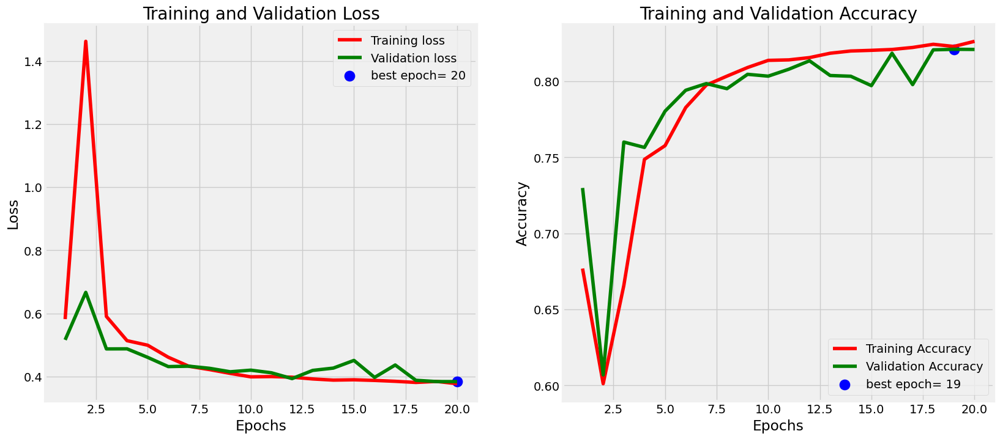

In [21]:
plot_training(result)

In [22]:
score = m1.evaluate(A_test, B_test, verbose=1)
print('Test loss, acc, dice, precision, recall):', score)

94/94 [==============================] - 5s 44ms/step - loss: 0.3022 - accuracy: 0.8703 - dice_coefficient: 0.7429 - precision_smooth: 0.7301 - recall_smooth: 0.7569
Test loss, acc, dice, precision, recall): [0.3021690547466278, 0.8703096508979797, 0.742875337600708, 0.7301271557807922, 0.7569436430931091]


# [ Bayesian Neural Network ]

In [23]:
def predict(model, image, gt, T=20):
    
    # add batch dimension
    image = np.expand_dims(image, 0)
    gt = np.expand_dims(gt, 0)
    
    # predict stochastic dropout model T times
    p_hat = []
    for t in range(T):
        p_hat.append( model.predict(image)[0] )
    p_hat = np.array(p_hat)
    
    # mean prediction
    prediction = np.mean(p_hat, axis=0)
    # threshold mean prediction
    #prediction = np.where(prediction > 0.5, 1, 0)
    
    # estimate uncertainties
    aleatoric = np.mean(p_hat*(1-p_hat), axis=0)
    epistemic = np.mean(p_hat**2, axis=0) - np.mean(p_hat, axis=0)**2
    
    loss, dice, prob, precision, recall = model.evaluate(image, gt, batch_size=1, verbose=0)

    return np.squeeze(prediction), np.squeeze(aleatoric), np.squeeze(epistemic), (dice, precision, recall)    

In [24]:
import time

num = len(A_test)
list_stochastic_feed_forwards = [3,5,10,15,20,30]
result_dict = {}
for ind, num_stochastic_T in enumerate(list_stochastic_feed_forwards):
    start = time.time()
    alea_list = []
    epis_list = []
    dice_list = []
    for i in range(num):
        image = A_test[i]
        gt    = B_test[i]
        prediction, aleatoric, epistemic, scores = predict(m1, image, gt, T=num_stochastic_T)
        alea_list.append(np.mean(aleatoric))
        epis_list.append(np.mean(epistemic))
        dice_list.append(scores[0])
    
    end = time.time()
    print('-'*30)
    print('T: ', num_stochastic_T)
    print('Time per prediction = {:.3f}'.format((end-start)/num))
    print('aleatoric: ', np.mean(alea_list), np.std(alea_list))
    print('epistemic: ', np.mean(epis_list), np.std(epis_list))    
    print('Dice: ', np.mean(dice_list), np.std(dice_list))  
    print('-'*30)
    
    result_dict.update({ '{}'.format(str(num_stochastic_T)) : 
    [num_stochastic_T, (end-start)/num,
     np.mean(alea_list), np.std(alea_list),
     np.mean(epis_list), np.std(epis_list),
     np.mean(dice_list), np.std(dice_list)]} )

------------------------------
T:  3
Time per prediction = 0.233
aleatoric:  0.116232716 0.021370003
epistemic:  1.3443328e-11 1.4537611e-10
Dice:  0.8703096618652344 0.09463559884810392
------------------------------
------------------------------
T:  5
Time per prediction = 0.349
aleatoric:  0.116232716 0.021370003
epistemic:  -1.7011406e-11 1.3707475e-10
Dice:  0.8703096618652344 0.09463559884810392
------------------------------
------------------------------
T:  10
Time per prediction = 0.630
aleatoric:  0.116232716 0.021370003
epistemic:  -1.6088391e-11 2.7360367e-10
Dice:  0.8703096618652344 0.09463559884810392
------------------------------
------------------------------
T:  15
Time per prediction = 0.925
aleatoric:  0.116232716 0.021370003
epistemic:  -6.1109386e-12 5.7546445e-10
Dice:  0.8703096618652344 0.09463559884810392
------------------------------
------------------------------
T:  20
Time per prediction = 1.206
aleatoric:  0.116232716 0.021370003
epistemic:  -6.030244

In [25]:
results = np.zeros((5, len(list_stochastic_feed_forwards)))
for ind, num_stochastic_T in enumerate(list_stochastic_feed_forwards):
    results[:, ind] = result_dict[str(num_stochastic_T)][1:6]

(0.0, 0.007)

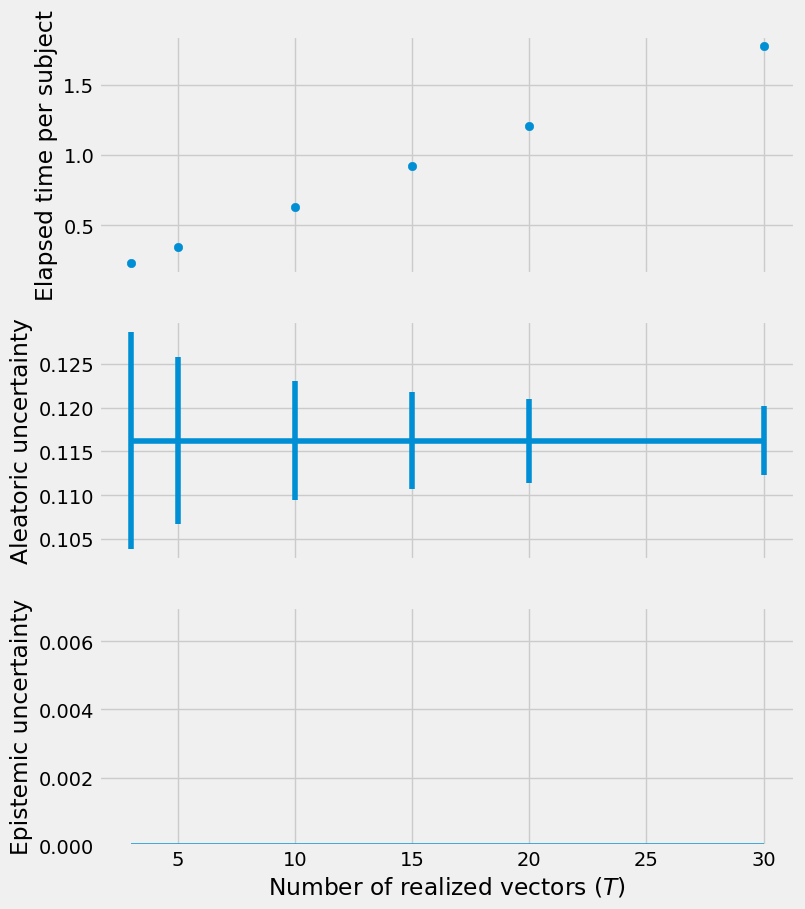

In [26]:
fig, ax = plt.subplots(nrows=3, ncols=1, figsize=(8,10), sharex=True)
# plot history for loss
ax[0].scatter(list_stochastic_feed_forwards,results[0])
ax[0].set_ylabel('Elapsed time per subject')
ax[1].errorbar(list_stochastic_feed_forwards,results[1], yerr=results[2]/np.sqrt(list_stochastic_feed_forwards))
ax[1].set_ylabel('Aleatoric uncertainty')
ax[2].errorbar(list_stochastic_feed_forwards,results[3], yerr=results[4]/np.sqrt(list_stochastic_feed_forwards))
ax[2].set_ylabel('Epistemic uncertainty')
ax[2].set_xlabel('Number of realized vectors ($T$)')
ax[2].set_ylim(0.00,0.007)
#plt.savefig('./fig/elapsed_time_vs_feed_200.pdf')

In [27]:
# Case T = 20
num = len(A_test)
start = time.time()
list_alea = []
list_epis = []
for i in range(num):
    image = A_test[i]
    gt    = B_test[i]
    prediction, aleatoric, epistemic, scores = predict(m1, image, gt, T=20)
    list_alea.append(aleatoric.reshape(-1))
    list_epis.append(epistemic.reshape(-1))

end = time.time()
print('Exec time per prediction = {:.3f}'.format((end-start)/num))
print('aleatoric: ', np.mean(list_alea))
print('epistemic: ', np.mean(list_epis))

Exec time per prediction = 1.195
aleatoric:  0.11623296
epistemic:  -6.030241e-11


In [28]:
list_alea = np.hstack(list_alea)
list_epis = np.hstack(list_epis)

print('aleatoric mean: ', np.mean(list_alea))
print('epistemic mean: ', np.mean(list_epis))

aleatoric mean:  0.11623296
epistemic mean:  -6.030241e-11


# [ Bivariate density plot for aleatoric & epistemic ]

In [29]:
threshold = np.percentile(list_alea, 99)
alea_index = (list_alea > threshold)

/home/jung/anaconda3/envs/tf/lib/python3.9/site-packages/seaborn/distributions.py:693: UserWarning: Passing a 2D dataset for a bivariate plot is deprecated in favor of kdeplot(x, y), and it will cause an error in future versions. Please update your code.
  warnings.warn(warn_msg, UserWarning)


Text(0, 0.5, 'Epistemic')

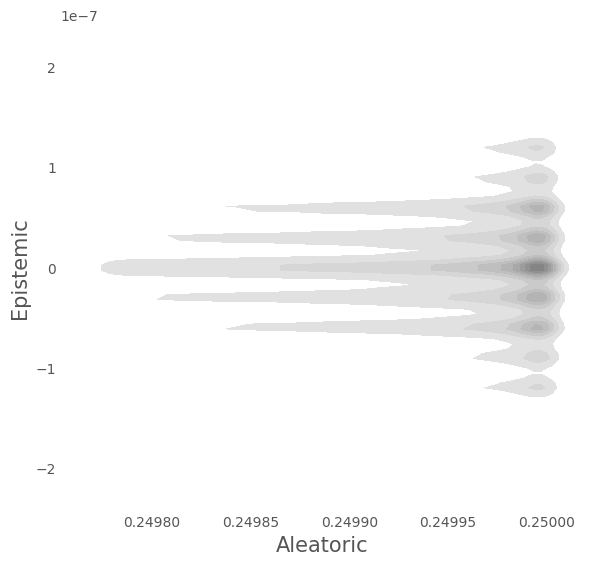

In [48]:
plt.style.use('ggplot')

plt.figure(figsize=(6,6))
data = np.vstack([list_alea[alea_index], list_epis[alea_index]]).T
ax = sns.kdeplot(data, shade = True, color = "gray", cbar=False)
ax.patch.set_facecolor('white')
ax.collections[0].set_alpha(0)
ax.set_xlabel('Aleatoric', fontsize = 15)
ax.set_ylabel('Epistemic', fontsize = 15)
#ax.set_xlim(0.15, 0.25)
#ax.set_ylim(0, 0.1)
#plt.savefig('./fig/epis_vs_alea_200.pdf')

In [49]:
def predict(model, image, gt, T=10):
    
    # add batch dimension
    image = np.expand_dims(image, 0)
    gt = np.expand_dims(gt, 0)
    
    # predict stochastic dropout model T times
    p_hat = []
    for t in range(T):
        p_hat.append( model.predict(image)[0] )
    p_hat = np.array(p_hat)
    
    # mean prediction
    prediction = np.mean(p_hat, axis=0)
    # threshold mean prediction
    #prediction = np.where(prediction > 0.5, 1, 0)
    
    # estimate uncertainties (eq. 4 )
    # eq.4 in https://openreview.net/pdf?id=Sk_P2Q9sG
    # see https://github.com/ykwon0407/UQ_BNN/issues/1
    aleatoric = np.mean(p_hat*(1-p_hat), axis=0)
    epistemic = np.mean(p_hat**2, axis=0) - np.mean(p_hat, axis=0)**2
    
    loss, dice, prob, precision, recall = model.evaluate(image, gt, batch_size=1, verbose=0)

    return np.squeeze(prediction), np.squeeze(aleatoric), np.squeeze(epistemic), (dice, precision, recall)

def display_all(i):
    #i=11

    im = A_test[i]
    gtgt = B_test[i]
    pred, ale, epi, sc = predict(m1, im, gtgt, T=num_stochastic_T)


    # 서브플롯 생성
    fig, ((ax1, ax2, ax3, ax4, ax5, ax6)) = plt.subplots(1, 6, figsize=(20, 4))

    # 첫 번째 : 원본
    ax1.imshow(im)
    ax1.set_title('Input image')

    # 두 번째 : Aleatoric
    ax2.imshow(ale)#, cmap='gray')
    ax2.set_title('Aleatoric')

    # 세 번째 : Epistemic
    ax3.imshow(epi)#, cmap='gray')
    ax3.set_title('Epistemic')

    # 네 번째 : Aleatoric + Epistemic
    ax4.imshow(ale+epi)#, cmap='gray')
    ax4.set_title('Aleatoric+Epistemic')

    # 다섯 번째 : Prediction
    ax5.imshow(pred)#, cmap='gray')
    ax5.set_title('Prediction')

    # 다섯 번째 : Ground Truth
    ax6.imshow(gtgt)#, cmap='gray')
    ax6.set_title('Ground Truth')

    # 서브플롯 간격 조정 및 표시
    plt.tight_layout()
    plt.show()

In [50]:
np.shape(A_test)

(3000, 256, 256, 3)

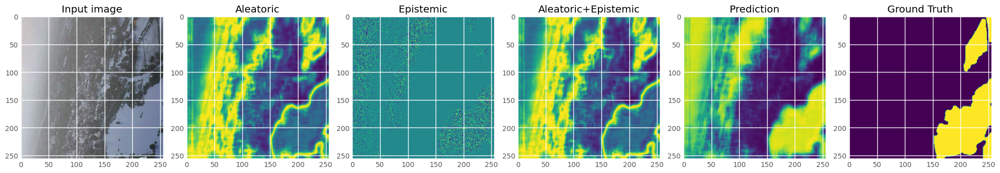

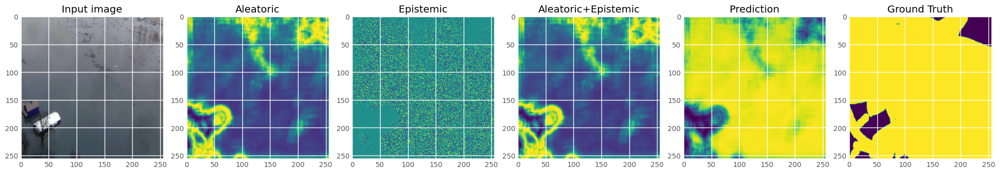

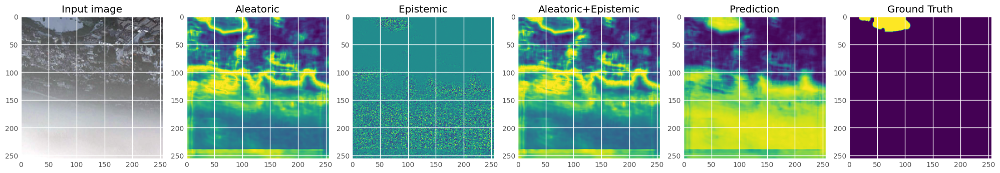

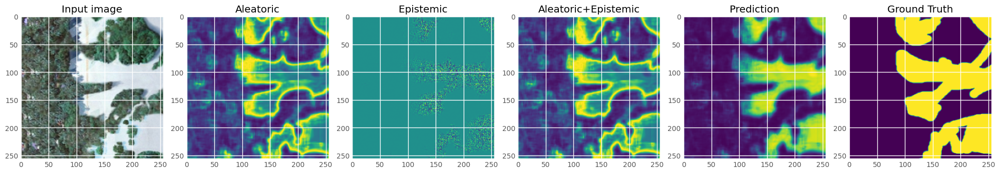

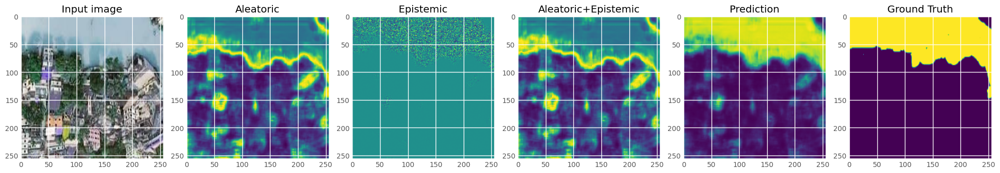

...

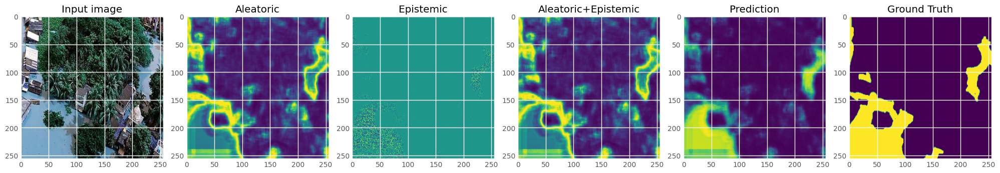

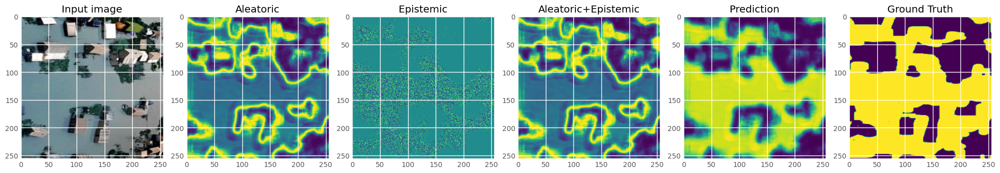

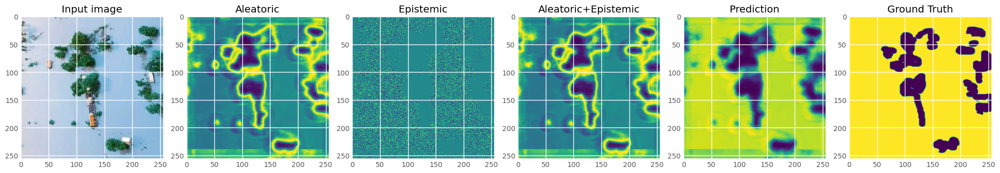

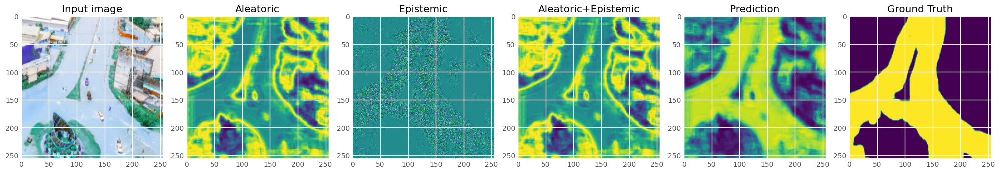

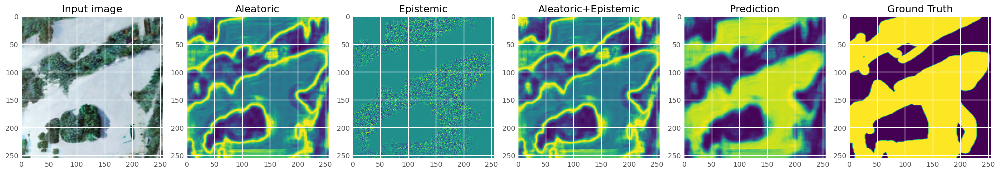

In [54]:
import random
random_numbers = random.sample(range(0, 1000), 30)
random_numbers

for i in random_numbers:
    display_all(i)